<a href="https://colab.research.google.com/github/chowwin/Coursera_Capstone/blob/main/The_Battle_of_the_Neighborhoods_Tackling_Food_Insecurity_in_NYC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# The Battle of the Neighborhoods: Tackling Food Insecurity in NYC
## Applied Data Science Capstone 

### 1. Introduction

Effective use of government resources to build and sustain healthy, food-secure cities has become increasingly crucial as cities like NYC invest increasing resources to support sustainable and resilient food systems, enhance food security among its residents, and improve awareness of and access to nutritious foods[1]. The crisis of urban food deserts, or areas of poor-food access demonstrated by a dearth of groceries stores and/or surplus of fast food options should there be a range of restaurants the area coincides with growing interest in designing systems to address the correlated poor health outcomes in these areas. Consider that health disparities coincide between zip codes and occur along food dessert borders, and it becomes clear the complexity and criticality of creating equitable access to healthy food options. 

#### Business Problem and Target Audience

To effectively address the problems urban food desserts present to residents and their health, we must understand where these food deserts are located. This is something that would be particularly useful for both a) citizens/grassroot organizers to, for instance, organize local farmers markets, community gardens or a networked system of local urban farmers and b) government officials to efficiently allocate government resources to address the paucity of healthy food options, which could include incentives for business like grocery stores or restaurants or targeting food education at schools, or targeting services like reduced-fee school lunches in neighborhoods designated as food deserts. 

This project aims to answer, "Where are the food deserts in New York City located?" and "Which neighborhoods would benefit the most from having a local farmers' market, government incentives, or other interventions to address poor access to healthy food options?". 

### 2. Data 

To answer these questions, New York City's boroughs and neighborhood boundaries and geographic coordinates including latitudes and longitudes will be obtained from https://cocl.us/new_york_dataset. Foursquare's API and GeoPy will be used to explore New York City venues. Specifically, get requests to Foursquare's API will be used to and identify and locate restaurants, supermarkets, and grocery stores in each of the city's neighborhoods, thus providing an idea of the number of each per neighborhood. From there, chloropleth maps of these clusters and neighborhoods can be visualized using Folium.

### 3. Methodology

#### 3a. Import and Explore Dataset

In [4]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analysis
#to see full dataframe
pd.set_option('display.max_columns', None) 
pd.set_option('display.max_rows', None)

# visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns

import json # library to handle JSON files
!pip install geopy
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

!pip install folium
import folium # map rendering library

print('Libraries imported.')

Libraries imported.


In [5]:
#function that returns the geographic coordinates of a given location
def geo_location(address):
    geolocator = Nominatim(user_agent="ny_explorer")
    location = geolocator.geocode(address)
    latitude = location.latitude
    longitude = location.longitude
    return latitude,longitude

In [8]:
#@title Foursquare Credientials
CLIENT_ID = 'STFHMTGWOKN1WDVO0ZFLUXJNXZGATEUWUMCSY2J4SX4A3ZH1' # your Foursquare ID
CLIENT_SECRET = 'F5HYLVRXBK5U2LLTUMCQDPVM52TQWK3XVFHXFOZCJQ2QRKV0' # your Foursquare Secret
ACCESS_TOKEN = 'TS4OHMHQEHF3E42WQ3ZO302TYYJC2V2CWBKJHCK13RKSYQKY' # your FourSquare Access Token
VERSION = '20180605' # Foursquare API version

print('Your credentials have been loaded.')

Your credentials have been loaded.


In [ ]:
#@title Foursquare Credentials
CLIENT_ID = "WXJ5ZLI2DDQQSAFTDLSKGUCNDYOXJJNCFM41N10UJOQHKNTC"
CLIENT_SECRET = "DXWB24ENKBC23YI3FMVNRUXMPB10ZDYCQALAUAH1RFPI0Y5Z"
ACCESS_TOKEN = 'TS4OHMHQEHF3E42WQ3ZO302TYYJC2V2CWBKJHCK13RKSYQKY' # your FourSquare Access Token
VERSION = '20180605' # Foursquare API version

print('Your credentials have been loaded.')

Your credentials have been loaded.


In [11]:
#function to get nearby using Foursquare API
def get_food_venues(lat,lng):
    radius=1000
    LIMIT=100
    #limit search to select Foursquare categories ['Food & Drink Shop', 'Supermarket', 'Grocery Stores', 'Fruit & Vegetable Store', 'Organic Grocery']
    #category_ids = '4bf58dd8d48988d1f9941735, 52f2ab2ebcbc57f1066b8b46, 4bf58dd8d48988d118951735, 52f2ab2ebcbc57f1066b8b1c, 52f2ab2ebcbc57f1066b8b45'
    url = 'https://api.foursquare.com/v2/venues/search?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId=4bf58dd8d48988d1f9941735,52f2ab2ebcbc57f1066b8b46,4bf58dd8d48988d118951735,52f2ab2ebcbc57f1066b8b1c,52f2ab2ebcbc57f1066b8b45'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
    results = requests.get(url).json()
    if results['response'] == {}:
      print('Foursquare API unable to get requests. Quota may be exceeded.')
    if len(results['response']['venues'])== 0 :
      print('no venues found in neighborhood')
    venue_data=results["response"]['venues']
    venue_details=[]
    for item in venue_data:
        try:
            venue_id=item['id']
            venue_name=item['name']
            venue_category=item['categories'][0]['name']
            venue_lat=item['location']['lat']
            venue_lng=item['location']['lng']
            venue_details.append([venue_id,venue_name,venue_category, venue_lat, venue_lng])
        except KeyError:
            pass
        
    column_names=['ID','Name','Category','Venue Latitude', 'Venue Longitude']
    df = pd.DataFrame(venue_details,columns=column_names)
    return df

In [12]:
def center_geolocation_approx(points):
    """Approximate the center of a location with boundary points given as a list of lists e.g., 
          ( [
            [-73.9760507905698, 40.6312841471042], 
            [-73.9771665542679, 40.6307548954438], 
            [-73.9769999234971, 40.6298797372738]
            ])"""
    x_coords = [p[0] for p in points]
    y_coords = [p[1] for p in points]
    _len = len(points)
    centroid_x = sum(x_coords)/_len
    centroid_y = sum(y_coords)/_len
    return [centroid_x, centroid_y]

In [13]:
#function to create new york city dataframe from population data https://data.cityofnewyork.us/resource/swpk-hqdp.json and https://services5.arcgis.com/GfwWNkhOj9bNBqoJ/arcgis/rest/services/NYC_Neighborhood_Tabulation_Areas/FeatureServer/0/query?where=1=1&outFields=*&outSR=4326&f=geojson
#Transform JSON file containing neighborhood data as nested Python dictionaries into a pandas dataframe
def get_new_york_data():
    
    # get neighborhood data
    url_1='https://services5.arcgis.com/GfwWNkhOj9bNBqoJ/arcgis/rest/services/NYC_Neighborhood_Tabulation_Areas/FeatureServer/0/query?where=1=1&outFields=*&outSR=4326&f=geojson'
    resp_1=requests.get(url_1).json()
    # all data is present in features label
    features_1=resp_1['features']
    # define dataframe columns
    column_names = ['Borough', 'Neighborhood Tabulation Area', 'NTA Code', 'Latitude', 'Longitude'] 
    # instantiate the dataframe for neighborhoods and their geographic coordinates
    new_york_data = pd.DataFrame(columns=column_names)
    for data in features_1:
        borough = data['properties']['BoroName'] 
        NTA = data['properties']['NTAName']
        NTACode = data['properties']['NTACode']
        if type(data['geometry']['coordinates'][0][0][0]) is list:
          neighborhood_latlng = center_geolocation_approx(data['geometry']['coordinates'][0][0])
        else:
          neighborhood_latlng = center_geolocation_approx(data['geometry']['coordinates'][0])
        neighborhood_lat = neighborhood_latlng[1]
        neighborhood_lng = neighborhood_latlng[0]
        new_york_data = new_york_data.append({'Borough': borough,
                                          'Neighborhood Tabulation Area': NTA,
                                          'NTA Code': NTACode,
                                          'Latitude': neighborhood_lat, 
                                          'Longitude': neighborhood_lng
                                          },ignore_index=True)

    # get population data
    url_2='https://data.cityofnewyork.us/resource/swpk-hqdp.json'
    resp_2=requests.get(url_2).json()
    # define dataframe columns for population data
    pop_column_names = ['NTA Code', 'Population'] 
    # instantiate the dataframe for neighborhoods and their geographic coordinates
    pop_data = pd.DataFrame(columns=pop_column_names)
    for data in resp_2:
      if data['year'] == '2010':
        NTACode = data['nta_code']
        population = data['population']
        pop_data = pop_data.append({'NTA Code': NTACode,
                                    'Population': population
                                          },ignore_index=True)
        
    # merge neighborhood and population dataframes together by 'NTA Code'
    merged_data = pd.merge(new_york_data, pop_data, how="inner", on='NTA Code')
    return merged_data

In [14]:
nyc_data = get_new_york_data()

In [15]:
nyc_data

,Borough,Neighborhood Tabulation Area,NTA Code,Latitude,Longitude,Population
0,Brooklyn,Borough Park,BK88,40.630667,-73.987897,106357
1,Queens,Murray Hill,QN51,40.768102,-73.807672,51739
2,Queens,East Elmhurst,QN27,40.763467,-73.866047,23150
3,Queens,Hollis,QN07,40.710505,-73.764068,20269
4,Brooklyn,Homecrest,BK25,40.598383,-73.964717,44316
5,Queens,Fresh Meadows-Utopia,QN41,40.734991,-73.785528,17812
6,Queens,St. Albans,QN08,40.692729,-73.764223,48593
7,Queens,Jamaica Estates-Holliswood,QN06,40.719044,-73.778646,25480
8,Brooklyn,Madison,BK44,40.605536,-73.946374,38917
9,Brooklyn,Kensington-Ocean Parkway,BK41,40.640727,-73.976414,36891


Let us see how many boroughs and neighborhoods there in New York City, according to the dataset.

In [28]:
print('This dataset has {} boroughs and is divided into {} Neighborhood Tabulations Areas (NTAs).'.format(len(nyc_data['Borough'].unique()),
        nyc_data.shape[0]))

This dataset has 5 boroughs and is divided into 195 Neighborhood Tabulations Areas (NTAs).


In [38]:
address = 'New York City, NY'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of New York City are 40.7127281, -74.0060152.


#### 3b. Explore Supermarkets in New York City

##### Get Food Venues



Now that the data containing New York City's neighborhoods and their location has been loaded, let us see how many supermarkets are in each neighborhood. The Foursquare API will be used to explore the neighborhoods based on their relative count of food and drink shops, supermarkets, grocery stores, fruit and vegetable stores, and organic grocery stores. We will run a search for each neighborhood using the coordinates in our dataframe. 

In [29]:
# prepare neighborhood list that contains food stores(get_food_venues)
column_names=['Borough', 'Neighborhood', 'Latitude', 'Longitude','ID','Name', 'Venue Latitude', 'Venue Longitude']
food_nyc=pd.DataFrame(columns=column_names)
count=1
for row in nyc_data.values.tolist():
  Borough, Neighborhood, NTACode, Latitude, Longitude, Population=row
  venues=get_food_venues(Latitude,Longitude) 
  if venues.empty==False:
      print('(',count,'/',len(nyc_data),')','Food stores in '+Neighborhood+', '+Borough+':'+str(len(venues)))
      for shop in venues.values.tolist():
          id, name , category, venue_lat, venue_lng=shop
          food_nyc = food_nyc.append({'Borough': Borough,
                                        'Neighborhood': Neighborhood,
                                        'Latitude': Latitude,
                                        'Longitude': Longitude,
                                        'Category' : category,
                                        'ID': id,
                                        'Name' : name,
                                        'Venue Latitude' : venue_lat,
                                        'Venue Longitude' : venue_lng
                                        }, ignore_index=True)
      count+=1
  else:
      print('(',count,'/',len(nyc_data),')','Food stores in '+Neighborhood+', '+Borough+':'+str(0))
      count+=1

( 1 / 195 ) Food stores in Borough Park, Brooklyn:46
( 2 / 195 ) Food stores in Murray Hill, Queens:16
( 3 / 195 ) Food stores in East Elmhurst, Queens:21
( 4 / 195 ) Food stores in Hollis, Queens:16
( 5 / 195 ) Food stores in Homecrest, Brooklyn:45
( 6 / 195 ) Food stores in Fresh Meadows-Utopia, Queens:16
( 7 / 195 ) Food stores in St. Albans, Queens:6
( 8 / 195 ) Food stores in Jamaica Estates-Holliswood, Queens:17
( 9 / 195 ) Food stores in Madison, Brooklyn:47
( 10 / 195 ) Food stores in Kensington-Ocean Parkway, Brooklyn:47
( 11 / 195 ) Food stores in Erasmus, Brooklyn:46
( 12 / 195 ) Food stores in Longwood, Bronx:47
( 13 / 195 ) Food stores in Clinton Hill, Brooklyn:49
( 14 / 195 ) Food stores in Cambria Heights, Queens:7
( 15 / 195 ) Food stores in Midwood, Brooklyn:38
( 16 / 195 ) Food stores in Gravesend, Brooklyn:22
( 17 / 195 ) Food stores in Bensonhurst East, Brooklyn:48
( 18 / 195 ) Food stores in Williamsburg, Brooklyn:45
( 19 / 195 ) Food stores in Bedford, Brooklyn:49

In [39]:
# ensure dataframe looks as expected
food_nyc

,Borough,Neighborhood,Latitude,Longitude,ID,Name,Venue Latitude,Venue Longitude,Category
0,Brooklyn,Borough Park,40.630667,-73.987897,5b4fa31ce7a237002c80bcd5,Kosher Discount Grocery,40.634590,-73.992178,Grocery Store
1,Brooklyn,Borough Park,40.630667,-73.987897,4bd1b5c0046076b030467271,D. Coluccio & Sons,40.629785,-74.000250,Cheese Shop
2,Brooklyn,Borough Park,40.630667,-73.987897,5002dbc9e4b07b9576abba71,m. bochner,40.630439,-73.986162,Grocery Store
3,Brooklyn,Borough Park,40.630667,-73.987897,4b340eeaf964a5208d2425e3,ShopRite of Avenue I,40.626620,-73.977079,Grocery Store
4,Brooklyn,Borough Park,40.630667,-73.987897,4fede8c8e4b0c594c2279739,thriffty beverage center,40.628620,-73.981995,Liquor Store
5,Brooklyn,Borough Park,40.630667,-73.987897,4d3761653ffba14385875156,Golden Star Wines & Liquor,40.625919,-73.975739,Liquor Store
6,Brooklyn,Borough Park,40.630667,-73.987897,4cb23824ef1b3704639d4900,Mittelmans Grocery,40.629952,-73.986461,Grocery Store
7,Brooklyn,Borough Park,40.630667,-73.987897,4f3290a919836c91c7e43046,Boro Park Wine and Liquor Store,40.631683,-73.995983,Liquor Store
8,Brooklyn,Borough Park,40.630667,-73.987897,570c27c1498e642236f8ea1a,Discount Wines & Liquors,40.631027,-73.976937,Liquor Store
9,Brooklyn,Borough Park,40.630667,-73.987897,4d6e86f4619a236adc7d748f,A.B. Liquor,40.635604,-73.995483,Liquor Store


In [32]:
food_nyc.to_csv('food_nyc.csv')

In [40]:
food_nyc.shape

(6039, 9)

In [41]:
print('Based on our calls to the Foursquare API, we gathered {} total food stores in New York City. Let us now see where they are located on a map.'.format(food_nyc.shape[0]))

Based on our calls to the Foursquare API, we gathered 6039 total food stores in New York City. Let us now see where they are located on a map.


##### Map Venues

In [42]:
# create map of New York City food stores using latitude and longitude values
map_newyork = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, borough, neighborhood, name in zip(food_nyc['Venue Latitude'], food_nyc['Venue Longitude'], food_nyc['Borough'], food_nyc['Neighborhood'], food_nyc['Name']):
    label = '{}, {}, {}'.format(neighborhood, borough, name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_newyork)  
    
map_newyork

This map gives us an idea of where these food stores are located in New York City. However, a choropleth map may better visualize neighborhoods of low food-store density. We will create a choropleth map after counting the number of food stores in each neighborhood.

In [82]:
#aggregate by counting number of food stores found in each neighborhood
partial_counts_df = food_nyc.Neighborhood.value_counts().reset_index()
partial_counts_df.columns = ['Neighborhood Tabulation Area', 'Number of Food Stores']
# merge counts with population data
counts_df = pd.merge(partial_counts_df, nyc_data, on=['Neighborhood Tabulation Area'], how='right')
counts_df.fillna(0, inplace=True)
counts_df['Number of Food Stores']=counts_df['Number of Food Stores'].astype(int)
counts_df['Population']=counts_df['Population'].astype(int)
# normalize number of food stores by population of each neighborhood
counts_df['Number of Food Stores (per million people)']=(counts_df['Number of Food Stores']/counts_df['Population'])*1000000
counts_df['Number of Food Stores (per million people)'].replace([np.inf, -np.inf], np.nan,inplace=True)
counts_df['Number of Food Stores (per million people)'].replace(np.nan, 0, inplace=True)

###### Choropleth Map by 'Number of Food Stores'

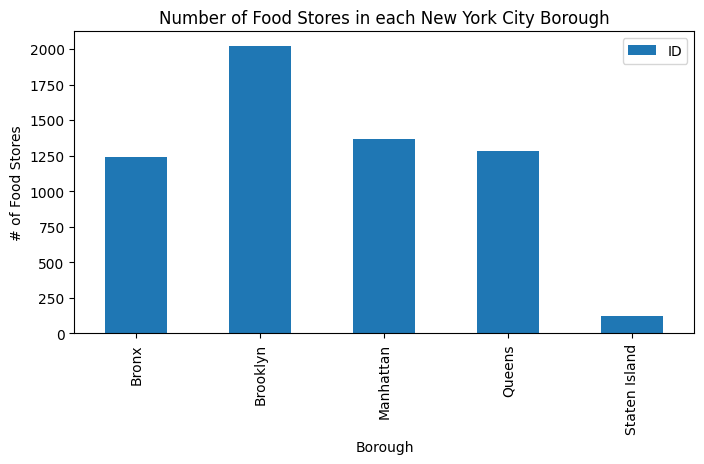

In [81]:
plt.figure(figsize=(8,4), dpi = 100)
plt.title('Number of Food Stores in each New York City Borough')
plt.xlabel('Borough', fontsize = 10)
plt.ylabel('# of Food Stores', fontsize=10)
food_nyc.groupby('Borough')['ID'].count().plot(kind='bar')
plt.legend()
#displays the plot
plt.show()

This plot shows that Staten Island has the fewest number of food stores compared to other boroughs. The plot above suggests that Staten Island stands to benefit the most from additional grocery stores, farmers' markets, or other government or grassroot iniative to address poor access to healthy food options. We should note, however, that this does not account for factors like the different number of neighborhoods in each borough (and thus the unequal number of times search requests to Foursquare were made for each borough).

In [77]:
import requests
import json
nyc_geo = json.loads(requests.get("https://services5.arcgis.com/GfwWNkhOj9bNBqoJ/arcgis/rest/services/NYC_Neighborhood_Tabulation_Areas/FeatureServer/0/query?where=1=1&outFields=*&outSR=4326&f=geojson").text)

In [78]:
# map neighborhoods and color by number of food stores
import folium

m = folium.Map(location=[40.738, -73.98], zoom_start=10)
m.choropleth(
 geo_data=nyc_geo,
 name='choropleth',
 data=counts_df,
 columns=['Neighborhood Tabulation Area', 'Number of Food Stores'],
 key_on='feature.properties.NTAName',
 fill_color='YlGnBu',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Number of Food Stores'
)
folium.LayerControl().add_to(m)
m


/usr/local/lib/python3.6/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


Neighborhoods with a high density of food stores are shown in dark blue and ones with few or no stores are shown in light yellow. The neighborhoods in yellow represent potential food desert areas, areas that may benefit the most from having additional grocery stores, food markets, business incentives, or other programs to address poor access to healthy food options. 

According to the choropleth map, we might conclude that Staten Island is the most food-insecure borough. This is, after all, supported by the plot above. However, while *number of food stores per neighborhood* serves as a decent proxy for food-insecurity, normalizing this metric by population per neighborhood might serve us better. Let us see how the map looks when we normalize based on population per neighborhood.

###### Choropleth Map by 'Number of Food Stores (Per Million People)'


In [49]:
# map neighborhoods and color by normalized metric, number of food stores (per million people)
m = folium.Map(location=[40.738, -73.98], zoom_start=10)
myscale = (counts_df['Number of Food Stores (per million people)'].quantile((0,0.2,0.4,0.6,0.8,1))).tolist()
m.choropleth(
 geo_data=nyc_geo,
 name='choropleth',
 data=counts_df,
 columns=['Neighborhood Tabulation Area', 'Number of Food Stores (per million people)'],
 key_on='feature.properties.NTAName',
 fill_color='YlGnBu',
 threshold_scale=myscale,
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Number of Food Stores (per million people)'
)
folium.LayerControl().add_to(m)
m

/usr/local/lib/python3.6/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In the following map, food store counts per capita have been scaled and colored by quantiles to better visualize neighborhoods. 6 color steps was kept constant between maps. After incorporating population data, Queens appears to have more neighborhoods with fewer food stores per capita than was suggested by the previous map.

In [ ]:
# map neighborhoods and color by normalized metric "number of food stores (per million people)" and adjust color scale to correspond with 10%, 25%, 50%, and 75% quantiles. 

m = folium.Map(location=[40.738, -73.98], zoom_start=10)
myscale = (counts_df['Number of Food Stores (per million people)'].quantile((0,0.1,0.25,0.5,0.75,1))).tolist()
m.choropleth(
 geo_data=nyc_geo,
 name='choropleth',
 data=counts_df,
 columns=['Neighborhood Tabulation Area', 'Number of Food Stores (per million people)'],
 key_on='feature.properties.NTAName',
 fill_color='YlGnBu',
 threshold_scale=myscale,
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Number of Food Stores (per million people)'
)
folium.LayerControl().add_to(m)
m

/usr/local/lib/python3.6/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


Let us use the metric that accounts for population density in each neighborhood *'Number of Food Stores(Per Million People)'* to see whether there is a certain borough where such programs would be especially beneficial.

<function matplotlib.pyplot.show>

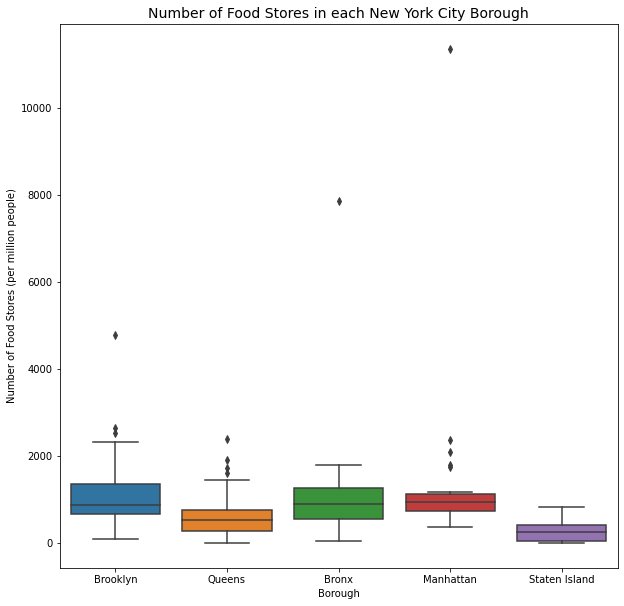

In [84]:
plt.figure(figsize=(10,10))
plt.title('Number of Food Stores in each New York City Borough', size=14)
sns.boxplot(
    data=counts_df,
    x='Borough', 
    y='Number of Food Stores (per million people)'
)
plt.show

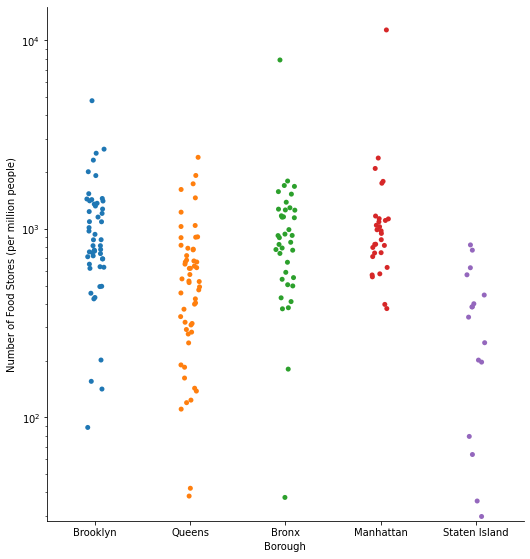

In [83]:
# Create a visualization scaled to enable greater resolution
#plt.title('Number of Food Stores in each New York City Borough', size=14)
g= sns.catplot(
    data=counts_df,
    x="Borough", 
    y='Number of Food Stores (per million people)'
)
g.fig.set_figwidth(8)
g.fig.set_figheight(8)
plt.yscale('log')

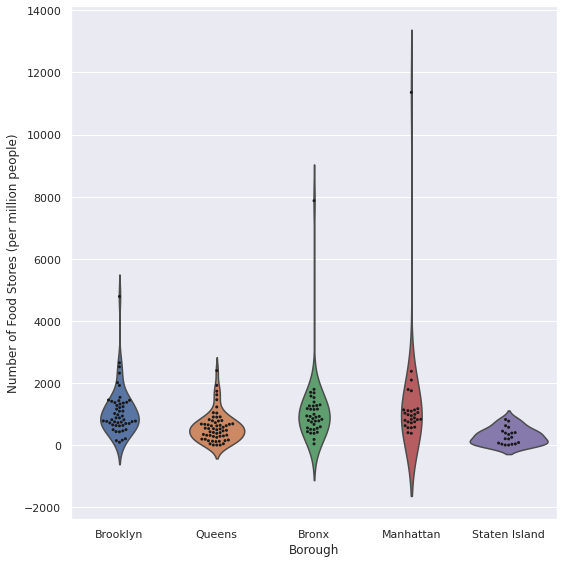

In [ ]:
# Apply the default theme
sns.set_theme()

# Create a visualization
plt.figure(figsize=(8,8))
ax = sns.violinplot(
    fig=fig,
    data=counts_df,
    x="Borough", 
    y='Number of Food Stores (per million people)',
    # kind="violin",
    inner=None
)
ax = sns.swarmplot(data=counts_df,
    x="Borough", 
    y='Number of Food Stores (per million people)',
    color="k", 
    size=3)
plt.show()

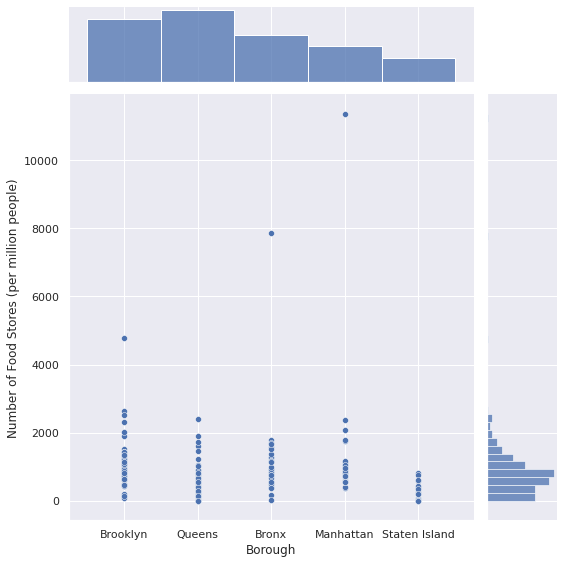

In [ ]:
# Create a visualization
g = sns.jointplot(
    data=counts_df,
    x='Borough', 
    y='Number of Food Stores (per million people)'
)
g.fig.set_figwidth(8)
g.fig.set_figheight(8)

The plots show that Staten Island and Queens have neighborhoods with the lowest number of food stores. Which neighborhoods are these? How many stores are there in these neighborhoods?

#### 3c. Analyze Each Neighborhood


We will subset the lowest decile of neighborhoods in terms of food stores per capita from our previous data. This will allow us to explore neighborhoods with the least number of fresh food options per capita and thus areas with the most need for fresh food availability. 

In [50]:
# Find neighborhoods with least 'Number of Food Stores (per million people)' 
lowest_decile = counts_df['Number of Food Stores (per million people)'].quantile(0.1)         # define lowest decile of food store counts
food_deserts=counts_df[counts_df['Number of Food Stores (per million people)'] <= lowest_decile]
food_deserts=food_deserts.sort_values(by=['Number of Food Stores (per million people)','Population'],ascending = (True, False))     # sort neighborhoods by decreasing order of need for greater fresh food availability, policy initiatives, etc.
food_deserts=food_deserts[food_deserts.Population != 0]      # remove neighborhoods with no population

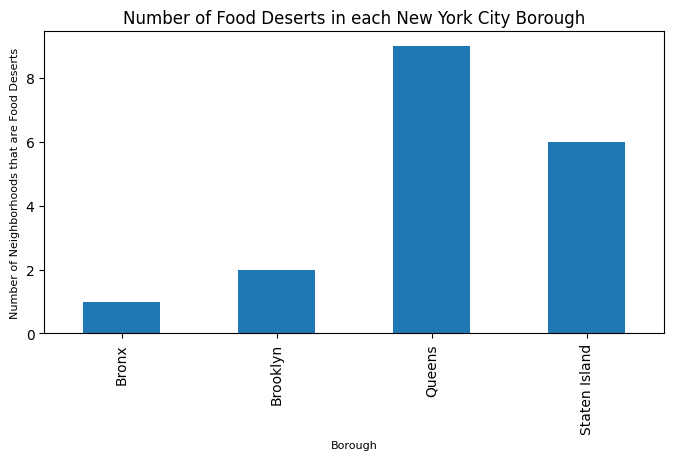

In [51]:
plt.figure(figsize=(8,4), dpi = 100)
plt.title('Number of Food Deserts in each New York City Borough')
plt.xlabel('Borough', fontsize = 8)
plt.ylabel('Number of Neighborhoods that are Food Deserts', fontsize=8)
food_deserts.groupby('Borough')['Number of Food Stores (per million people)'].count().plot(kind='bar')
#displays the plot
plt.show()

According to the chart above, Queens has the most neighborhoods with the least number of food stores per capita and Staten Island has the second most. Due to their low number of food stores, both boroughs provide the least competition (and consequently, perhaps the greatest opportunity) for fresh food providers like supermarkets, grocery stores, warehouse clubs, and farmers' markets. The top 10 candidates for government policy iniatitives and entrepreneurs seeking to tackle food insecurity in New York City are shown below:

In [88]:
food_deserts = food_deserts.reset_index(drop=True)
food_deserts.head(10)

,Neighborhood Tabulation Area,Number of Food Stores,Borough,NTA Code,Latitude,Longitude,Population,Number of Food Stores (per million people)
0,Todt Hill-Emerson Hill-Heartland Village-Light...,0,Staten Island,SI24,40.588734,-74.128291,30714,0.000000
1,College Point,0,Queens,QN23,40.787013,-73.868319,24275,0.000000
2,park-cemetery-etc-Queens,0,Queens,QN99,40.561416,-73.885595,436,0.000000
3,New Springville-Bloomfield-Travis,1,Staten Island,SI05,40.588981,-74.195838,39597,25.254438
4,West New Brighton-New Brighton-St. George,1,Staten Island,SI22,40.640229,-74.100609,33551,29.805371
5,Annadale-Huguenot-Prince's Bay-Eltingville,1,Staten Island,SI01,40.520514,-74.192894,27770,36.010083
6,Pelham Bay-Country Club-City Island,1,Bronx,BX10,40.834903,-73.788791,26583,37.618027
7,Lindenwood-Howard Beach,1,Queens,QN57,40.652526,-73.858685,26148,38.243843
8,Steinway,2,Queens,QN72,40.782045,-73.895760,47534,42.075146
9,Mariner's Harbor-Arlington-Port Ivory-Granitev...,2,Staten Island,SI12,40.642605,-74.159401,31474,63.544513


### 5. Results

According to this table, there are 3 neighborhood tabulation areas with no food stores within neighborhood perimeters despite hundreds if not tens of thousands of residents: 

1.   Todt Hill-Emerson Hill-Heartland Village-Lighthouse Hill
2.   College Point
3.   park-cemetery-etc-Queens

These areas can be considered food deserts and stand to benefit the most from additional grocery stores, farmers' markets, or other government or grassroot iniative to address poor access to healthy food options, especially "Todt Hill-Emerson Hill-Heartland Village-Lighthouse Hill" in Staten Island as is the most populous of the three areas.


### 6. Discussion

This analysis should be considered a starting point for further analysis. We must consider that the data gathered here is limited to the search limits per get request to the Foursquare API and thus does not include all food stores in the city. Future work might consider methods to produce a more robust and accurate dataset from Foursquare API. This could entail sectioning New York City into smaller geographic sections, rather than by neighborhoods whose geographic area is arbitrarily defined. Instead of analyzing the city by neighborhoods, the city could be divided into _x_ square meters. From there, the geographic coordinates of the center of these sections could be calculated and used for Foursquare API _search_ requests. Future work may look into the fast food restaurants in each neighborhood and examine the overlap of neighborhoods where there are few, if any, food stores and those where there are many fast food chains. 

### 7. Conclusion

This project aimed to answer, "Where are the food deserts in New York City located?" and "Which neighborhoods would benefit the most from having a local farmers' market, government incentives, or other interventions to address poor access to healthy food options?". 

Through this analysis, 3 neighborhood tabulations areas that can be considered food deserts in New York City were found: "Todt Hill-Emerson Hill-Heartland Village-Lighthouse Hill" in Staten Island, "College Point" in Queens, and "park-cemetery-etc-Queens" in Queens. Future policy incentives should focus efforts in these areas as residents in these areas stand to benefit the most from addditional fresh food availability.


### 8. References

[1] Gearing, Maeve E, and Theresa Anderson. “Innovations in NYC Health and Human Services Policy: Food Policy.” Urban Institute, Urban Institute, Feb. 2014, www.urban.org/sites/default/files/publication/32636/413054-Innovations-in-NYC-Health-and-Human-Services-Policy-Food-Policy.PDF. 

[2] Gordon C, Purciel-Hill M, Ghai NR, Kaufman L, Graham R, Van Wye G. Measuring food deserts in New York City's low-income neighborhoods. Health Place. 2011 Mar;17(2):696-700. doi: 10.1016/j.healthplace.2010.12.012. Epub 2011 Jan 6. PMID: 21256070.